# Qs 1: [2 Marks] Implement the Harris algorithm using OpenCV. 

**Harris Corner Detection** is a technique for identifying corners or spots of interest in images. Corners are points with a large variation in intensity in all directions, making them valuable for many computer vision applications such as feature matching and object recognition. The Harris algorithm calculates the corner response function for each pixel and identifies the spots where it is maximized. These are considered corners. The Harris algorithm is very good at finding corners that are insensitive to rotation and scale.


In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


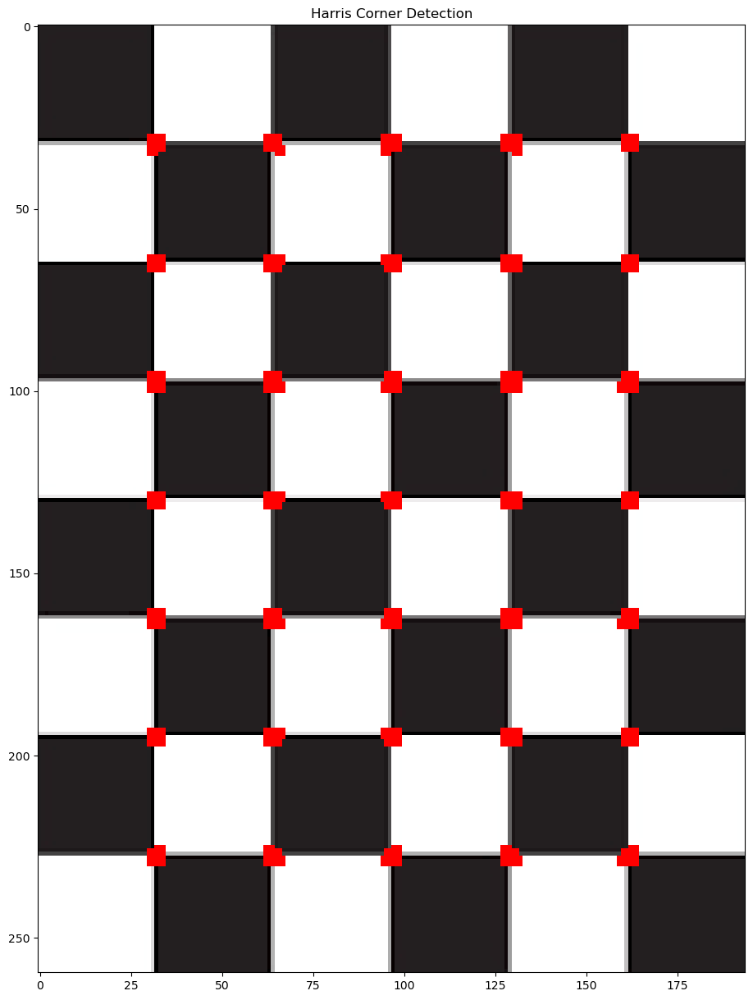

In [2]:
image = cv2.imread('download.png')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

gray = np.float32(gray)

dst = cv2.cornerHarris(gray, 2, 3, 0.04)

dst = cv2.dilate(dst, None)

image[dst > 0.01 * dst.max()] = [0, 0, 255]

plt.figure(figsize=(15, 15))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Harris Corner Detection')
plt.show()


# Qs 2: [2 Marks] Implement Image Pyramid using OpenCV

**Image Pyramid** is a multi-scale representation of an image in which many layers are produced at various resolutions. The Gaussian Pyramid is produced by gradually blurring and downsampling an image, resulting in a series of smaller images. In contrast, the Laplacian Pyramid depicts the difference between consecutive levels of the Gaussian Pyramid. Image pyramids are useful in a variety of applications, including image processing and computer vision, where working at many scales improves performance and accuracy.


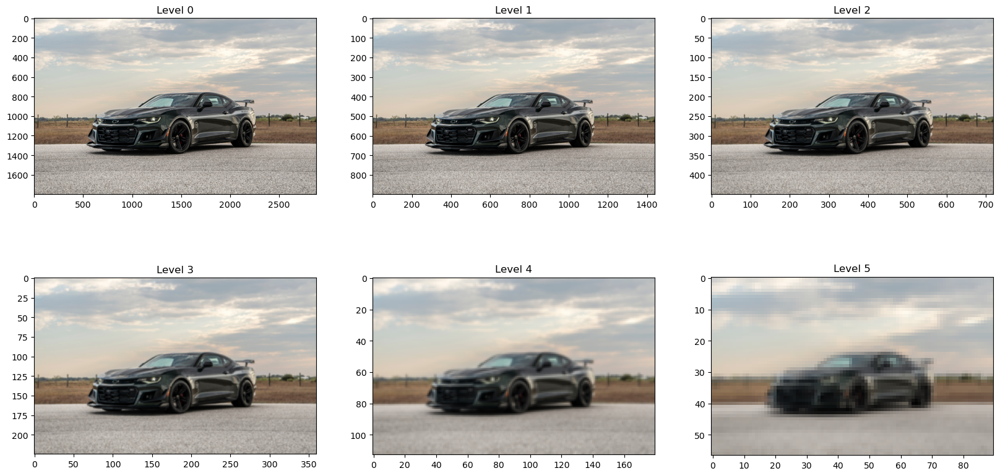

In [3]:
image_2 = cv2.imread('Images/hennessey-chevrolet-camaro-zl1-the-exorcist-final-edition-hk-2880x1800.jpg')

G = image_2.copy()
gp = [G]
for i in range(6):
    G = cv2.pyrDown(G)
    gp.append(G)

plt.figure(figsize=(20, 10))
for i in range(6):
    plt.subplot(2, 3, i+1)
    plt.imshow(cv2.cvtColor(gp[i], cv2.COLOR_BGR2RGB))
    plt.title(f'Level {i}')
plt.show()


# Qs 3: [3 Marks] Implement the SURF algorithm using OpenCV.
Or 
# [3 Marks] Implement Image Segmentation with Watershed Algorithm using OpenCV.

**Watershed Algorithm** is a powerful image segmentation method that views image intensity as topography. The system simulates flooding a terrain with different markers (seed locations). It determines the boundaries between distinct regions by tracing the lines where water would meet if flooding happened. This approach efficiently divides an image into distinct parts based on its intensity levels. It is frequently employed in situations when exact and comprehensive segmentation is required.


In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def process_and_display_image(image_path):
    image = cv2.imread(image_path)

    if image is None:
        print("Error: Could not load image.")
        return
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    edges = cv2.Canny(blurred, 50, 150)

    ret, markers = cv2.connectedComponents(edges)
    markers = markers + 1

    markers[edges == 0] = 0

    markers = cv2.watershed(image, markers)
    image[markers == -1] = [0, 0, 255] 


    images_to_show = [
        (image, 'Segmented Image'),
        (edges, 'Edges'),
        (gray, 'Grayscale Image'),
        (blurred, 'Blurred Image')
    ]


    plt.figure(figsize=(20, 8)) 
    for i, (img, title) in enumerate(images_to_show):
        plt.subplot(2, 2, i + 1)  
        if len(img.shape) == 2:  
            plt.imshow(img, cmap='gray')
        else: 
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(title)
        plt.axis('off')


    plt.show()




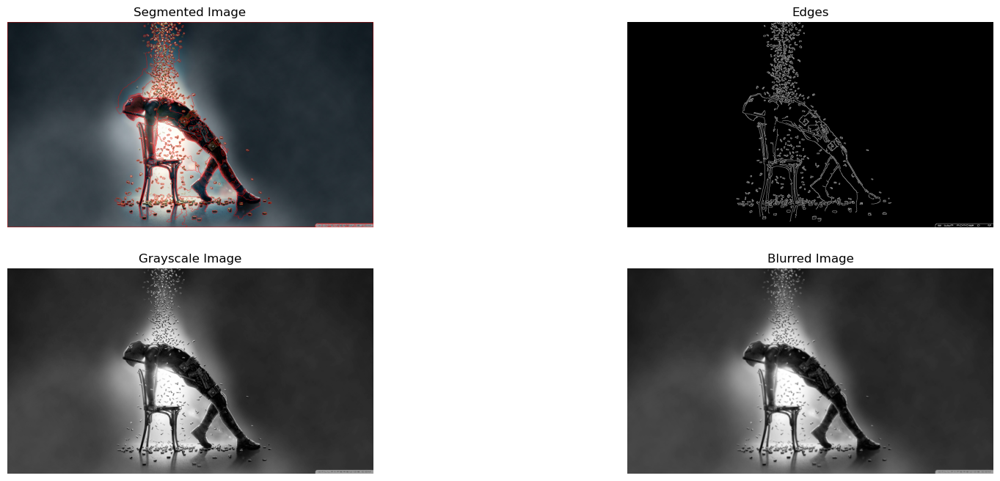

In [33]:
process_and_display_image('Images/deadpool_2_bullets-wallpaper-1366x768.jpg')

# 

# Qs 4: [3 Marks] Implement SIFT algorithm using OpenCV

**SIFT (Scale-Invariant Feature Transform)** is a feature detection technique that finds and describes local features in photos. SIFT recognizes keypoints that are insensitive to scale and rotation changes, allowing for accurate matching between images. The system creates descriptors for each keypoint that can be utilized in a variety of applications, including object recognition, image stitching, and 3D reconstruction. SIFT is especially effective when working with photos with several views or scales.


In [22]:
def detect_and_display_sift(image_path):
    image = cv2.imread(image_path)
    
    if image is None:
        print("Error: Could not load image.")
        return

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray, None)
    img_sift = cv2.drawKeypoints(image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(img_sift, cv2.COLOR_BGR2RGB))
    plt.title('SIFT Keypoints')
    plt.axis('off')

    plt.show()

    return img_sift

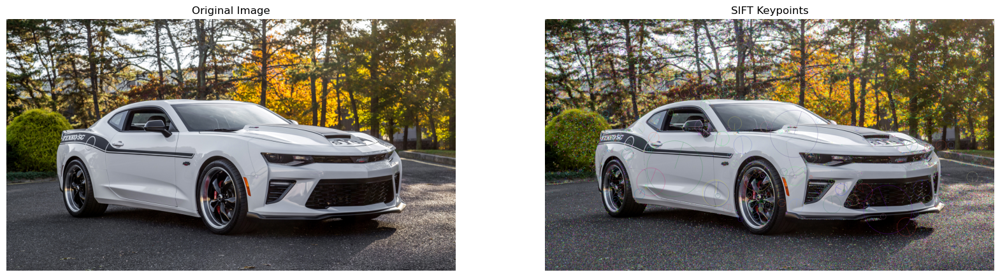

In [23]:
A = detect_and_display_sift('Images/2018_sve_chevrolet_camaro_yenkosc_stage_ii_4k-HD.jpg')

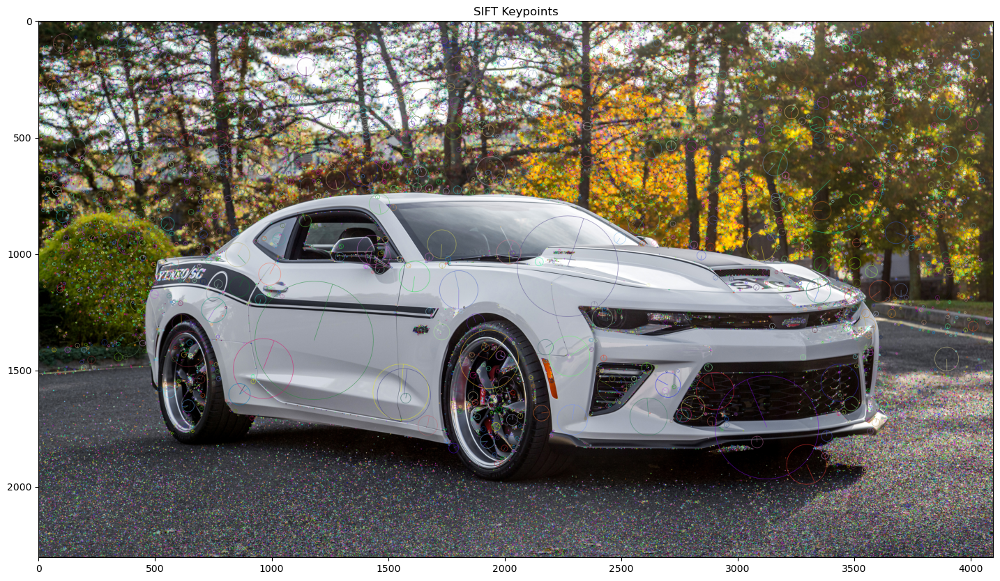

In [24]:
# Display the result
plt.figure(figsize=(20, 10))
plt.imshow(cv2.cvtColor(A, cv2.COLOR_BGR2RGB))
plt.title('SIFT Keypoints')
plt.show()


# 

# Qs 5: [5 Marks] Implement object detection using YOLO on the COCO dataset. Provide the results for any 5 images (for testing purposes) from the dataset.

**YOLO (You Only Look Once)** is a real-time object detection algorithm that divides an image into grid cells and predicts their bounding boxes and class probabilities. YOLO processes a whole image in a single pass, making it extremely efficient for object detection tasks. The COCO dataset includes pre-trained models and class labels that YOLO may utilize to identify a variety of objects. Using YOLO on the COCO dataset, you can detect and classify items in photos, generating bounding boxes and labels for recognized objects.


In [31]:
import os
import random

def load_yolo():
    net = cv2.dnn.readNet("yolov3.weights", "yolov3.cfg")
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers().flatten()]
    with open("coco.names", "r") as f:
        classes = [line.strip() for line in f.readlines()]
    return net, output_layers, classes

def detect_objects(image, net, output_layers):
    height, width, channels = image.shape
    blob = cv2.dnn.blobFromImage(image, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)
    return outs, width, height

def draw_labels(boxes, confidences, class_ids, classes, image):
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    font = cv2.FONT_HERSHEY_PLAIN
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            color = (0, 255, 0)
            cv2.rectangle(image, (x, y), (x + w, y + h), color, 2)
            cv2.putText(image, label, (x, y - 10), font, 1, color, 2)
    return image

def process_images_from_folder(folder_path, num_images, net, output_layers, classes):
    images = [os.path.join(folder_path, img) for img in os.listdir(folder_path) if img.endswith(('.jpg', '.jpeg', '.png'))]
    selected_images = random.sample(images, num_images)
    
    num_columns = 2
    num_rows = (num_images + num_columns - 1) // num_columns
    
    plt.figure(figsize=(20, 20))
    for i, img_path in enumerate(selected_images):
        image = cv2.imread(img_path)
        outs, width, height = detect_objects(image, net, output_layers)
        class_ids = []
        confidences = []
        boxes = []
        for out in outs:
            for detection in out:
                scores = detection[5:]
                class_id = np.argmax(scores)
                confidence = scores[class_id]
                if confidence > 0.5:
                    center_x = int(detection[0] * width)
                    center_y = int(detection[1] * height)
                    w = int(detection[2] * width)
                    h = int(detection[3] * height)
                    x = int(center_x - w / 2)
                    y = int(center_y - h / 2)
                    boxes.append([x, y, w, h])
                    confidences.append(float(confidence))
                    class_ids.append(class_id)
        image = draw_labels(boxes, confidences, class_ids, classes, image)

        plt.subplot(num_rows, num_columns, i + 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title(f'Image {i+1}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()


# COCO Data set images output : 

Enter the folder path containing images:  val2017
Enter the number of images to process:  5


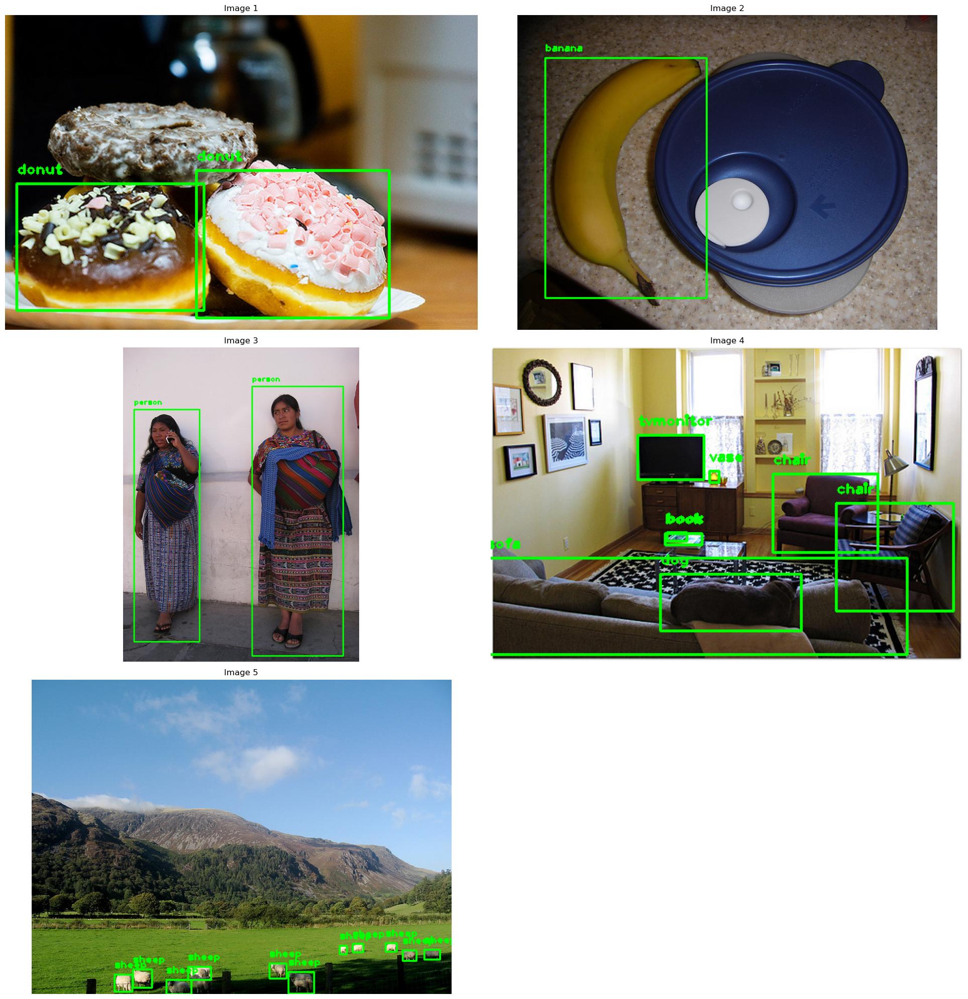

In [32]:
folder_path = input("Enter the folder path containing images: ")
num_images = int(input("Enter the number of images to process: "))
net, output_layers, classes = load_yolo()
process_images_from_folder(folder_path, num_images, net, output_layers, classes)

# My images output :

Enter the folder path containing images:  Images
Enter the number of images to process:  10


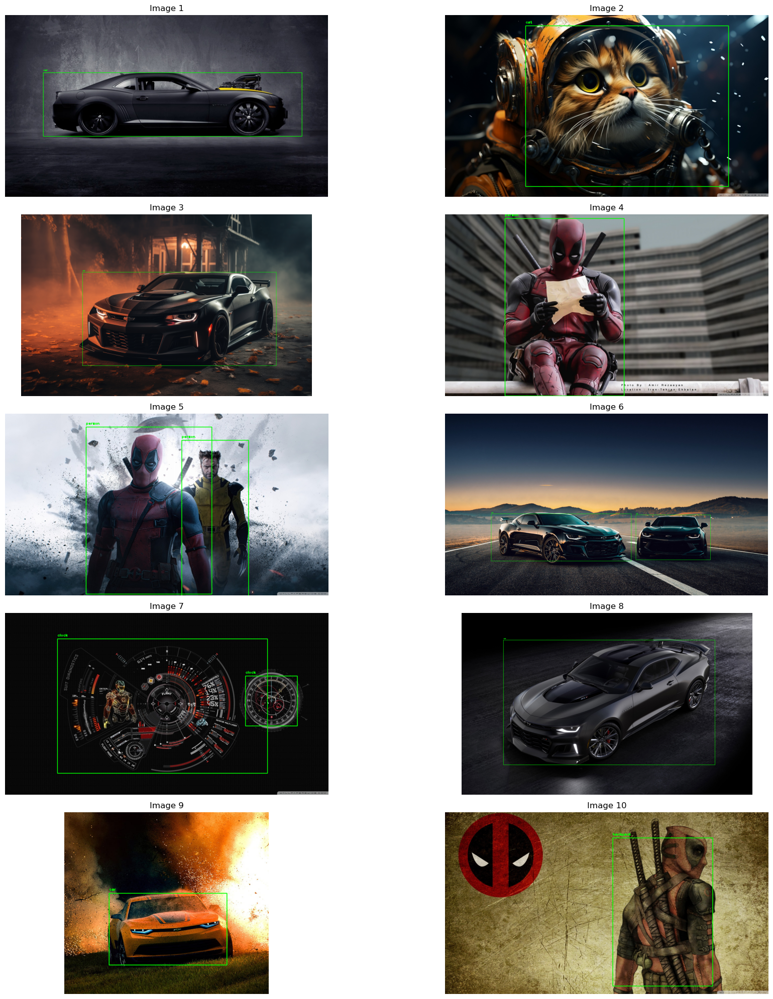

In [30]:
folder_path = input("Enter the folder path containing images: ")
num_images = int(input("Enter the number of images to process: "))
net, output_layers, classes = load_yolo()
process_images_from_folder(folder_path, num_images, net, output_layers, classes)

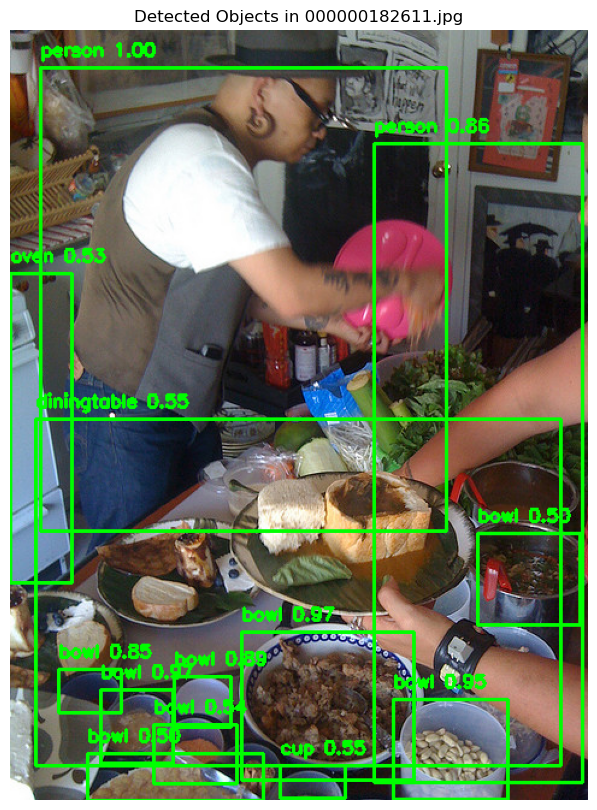

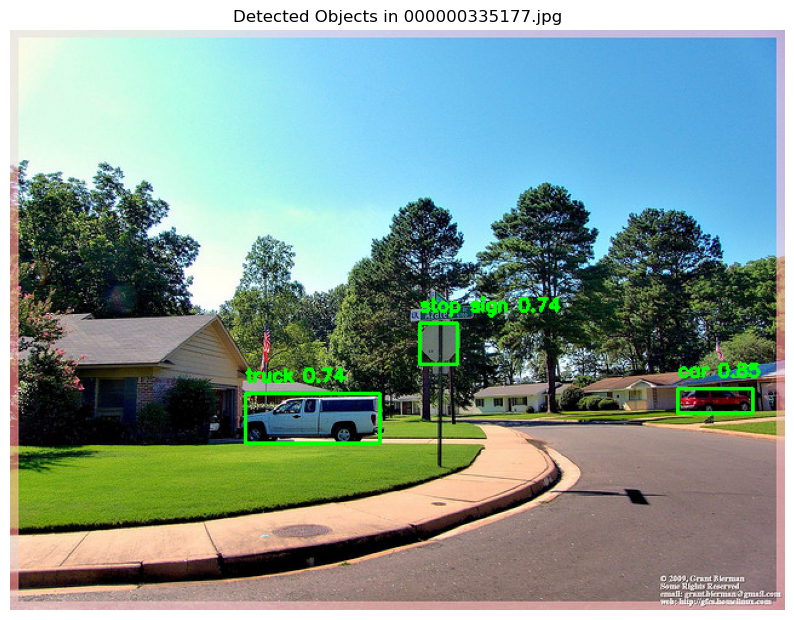

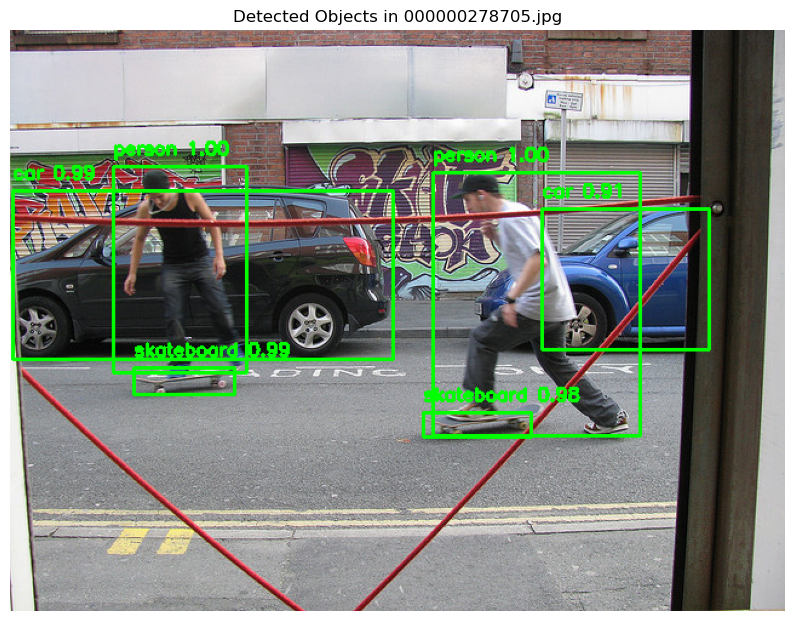

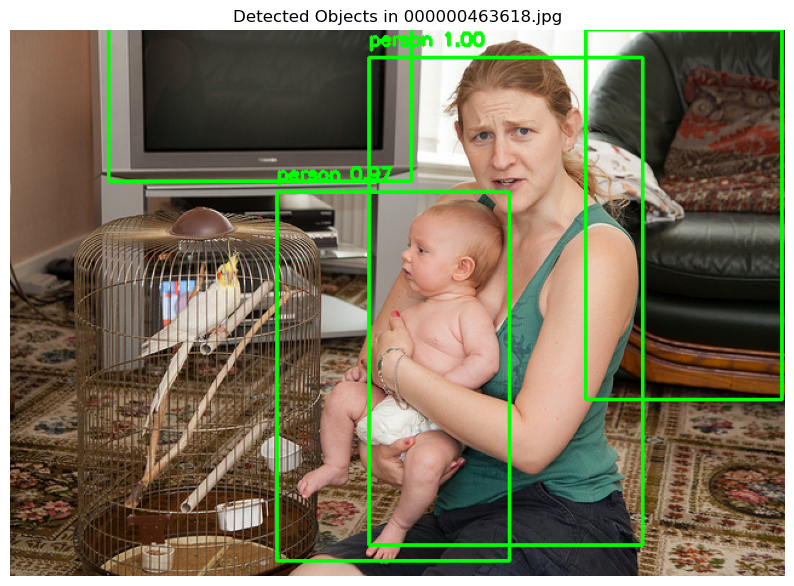

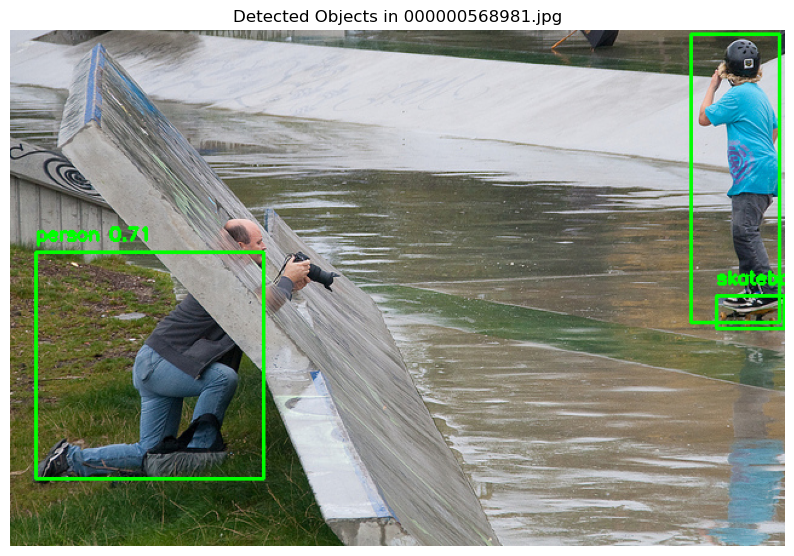

In [36]:
def plot_image(image, title):
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Load YOLOv3 weights and config
weights_path = 'yolov3.weights'  # Replace with path to your YOLOv3 weights file
config_path = 'yolov3.cfg'       # Replace with path to your YOLOv3 config file
coco_names_path = 'coco.names'   # Replace with path to your COCO names file

# Load YOLO model
net = cv2.dnn.readNet(weights_path, config_path)
layer_names = net.getLayerNames()
output_layer_indices = net.getUnconnectedOutLayers()

# Correctly handle the indices depending on the OpenCV version
if isinstance(output_layer_indices, (tuple, list, np.ndarray)) and len(output_layer_indices.shape) > 1:
    output_layer_indices = output_layer_indices.flatten()

output_layers = [layer_names[i - 1] for i in output_layer_indices]

# Load COCO class names
with open(coco_names_path, 'r') as f:
    classes = [line.strip() for line in f.readlines()]

def detect_objects(image):
    height, width, channels = image.shape
    blob = cv2.dnn.blobFromImage(image, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)

    class_ids = []
    confidences = []
    boxes = []

    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                class_ids.append(class_id)
                confidences.append(float(confidence))

    indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    for i in indices.flatten():
        box = boxes[i]
        x, y, w, h = box[0], box[1], box[2], box[3]
        label = str(classes[class_ids[i]])
        confidence = confidences[i]
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(image, f"{label} {confidence:.2f}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return image

# Path to the folder containing images
image_folder = 'val2017'  # Replace with path to your image folder

# List all image files in the folder
image_files = [f for f in os.listdir(image_folder) if os.path.isfile(os.path.join(image_folder, f))]
image_files = [f for f in image_files if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Process and display results for the first 5 images
for img_file in image_files[:5]:
    img_path = os.path.join(image_folder, img_file)
    image = cv2.imread(img_path)
    detected_image = detect_objects(image)
    plot_image(detected_image, f'Detected Objects in {img_file}')